# Dataset Creation

In [92]:
import pandas as pd
import numpy as np
import random
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')

# graph settings : 
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [93]:
def randomNumber(x):
    return random.randint(0,x)
def randomDate(x):
    return random.randint(5,x)
def randomYear(x):
    return random.randint(1,x)
def randomColor():
    r = lambda: random.randint(0,255)
    return ('#%02X%02X%02X' % (r(),r(),r()))
def randomDateCust():
    return random.randint(1,2)


In [94]:
# for ground owners
#(date-pk,year(not required),day, month, week number , groundName, timeslot chosen , sport chosen ) --> cost spent

years = ['2010','2011','2012','2013','2014','2015','2016','2017','2018','2019','2020','2021']

days = ['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']

groundNames = ['Ground1','Ground2','Ground3','Ground4']

timeslots = ['timeslot1','timeslot2','timeslot3','timeslot4','timeslot5','timeslot6','timeslot7']

months = ['January','February','March','April','May','June','July','August','September','October','November','December']

sports = ['sport1','sport2','sport3','sport4','sport5','sport6']

#for ground 1 : 
g1_prices = {'sport1':100,'sport2':150,'sport3':250,'sport4':350,'sport5':400,'sport6':200}
g2_prices = {'sport1':200,'sport2':150,'sport3':450,'sport4':250,'sport5':200,'sport6':100}
g3_prices = {'sport1':350,'sport2':450,'sport3':150,'sport4':200,'sport5':300,'sport6':250}
g4_prices = {'sport1':450,'sport2':250,'sport3':150,'sport4':100,'sport5':250,'sport6':500}


data = [] 
data2=[]
# assuming on an average,30 people and minimum 5 people visit the ground everyday 
for i in range(1,3000):  
    num_dates = randomDate(30)
    tot_cost=0
    tYear =""
    tDay=""
    tGroundName=""
    tTimeSlot=""
    tMonth =""
    tSport=""
    tDate = i
    tot_cust = num_dates
    day_cost = []
    
    for j in range(1,tot_cust):    
        tDay = days[randomNumber(len(days)-1)]
        tGroundName = groundNames[randomNumber(len(groundNames)-1)]
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        tMonth = months[randomNumber(len(months)-1)]
        if(tGroundName == 'Ground1'):
            tCost = g1_prices[tSport]
            day_cost.append(tCost)
            tot_cost+=tCost
        elif(tGroundName == 'Ground2'):
            tCost = g2_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground3'):
            tCost = g3_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        elif(tGroundName == 'Ground4'):
            tCost = g4_prices[tSport]
            day_cost.append(tCost)
            
            tot_cost+=tCost
        if(i<250):
            tYear = years[0]
        elif(i>=250 and i<500):
            tYear = years[1]
        elif(i>=500 and i<750):
            tYear = years[2]
        elif(i>=750 and i<1000):
            tYear = years[3]
        elif(i>=1000 and i<1250):
            tYear = years[4]
        elif(i>=1250 and i<1500):
            tYear = years[5]
        elif(i>=1500 and i<1750):
            tYear = years[6]
        elif(i>=1750 and i<2000):
            tYear = years[7]
        elif(i>=2000 and i<2250):
            tYear = years[8]
        elif(i>=2250 and i<2500):
            tYear = years[9]
        elif(i>=2500 and i<2750):
            tYear = years[10]
        elif(i>=2750 and i<3000):
            tYear = years[11]
        
            
        
            
    
    data.append([tDate,tYear,tDay,tMonth,tGroundName,tot_cost,tot_cust])
    for i in range(1,tot_cust):
        tTimeSlot = timeslots[randomNumber(len(timeslots)-1)]
        tSport = sports[randomNumber(len(sports)-1)]
        data2.append([tDate,tYear,tDay,tMonth,tTimeSlot,tSport,tGroundName,day_cost[i-1]])

groundOwners_df = pd.DataFrame(data, columns = ['Date','Year', 'Day','Month','GroundName','Cost','TotalCustomers'])

groundOwners_df_percust = pd.DataFrame(data2,columns = ['Date','Year', 'Day','Month','TimeSlot','Sport','GroundName','Cost'])

In [95]:
groundOwners_df

,Date,Year,Day,Month,GroundName,Cost,TotalCustomers
0,1,2010,Sunday,December,Ground2,6800,30
1,2,2010,Friday,July,Ground4,4800,20
2,3,2010,Wednesday,September,Ground3,3750,19
3,4,2010,Sunday,January,Ground2,1800,10
4,5,2010,Friday,August,Ground3,5350,19
...,...,...,...,...,...,...,...
2994,2995,2021,Sunday,June,Ground3,5300,21
2995,2996,2021,Tuesday,October,Ground1,1250,7
2996,2997,2021,Wednesday,January,Ground1,7550,29
2997,2998,2021,Monday,November,Ground1,1950,10


In [96]:
groundOwners_df_percust

,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost
0,1,2010,Sunday,December,timeslot4,sport5,Ground2,450
1,1,2010,Sunday,December,timeslot1,sport2,Ground2,350
2,1,2010,Sunday,December,timeslot1,sport2,Ground2,450
3,1,2010,Sunday,December,timeslot4,sport5,Ground2,150
4,1,2010,Sunday,December,timeslot6,sport3,Ground2,100
...,...,...,...,...,...,...,...,...
49589,2999,2021,Saturday,February,timeslot6,sport6,Ground2,150
49590,2999,2021,Saturday,February,timeslot6,sport1,Ground2,150
49591,2999,2021,Saturday,February,timeslot2,sport1,Ground2,450
49592,2999,2021,Saturday,February,timeslot4,sport1,Ground2,150


In [97]:
gO1_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground1']
gO2_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground2']
gO3_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground3']
gO4_Cost_df = groundOwners_df.loc[groundOwners_df['GroundName'] == 'Ground4']

gO1_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground1']
gO2_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground2']
gO3_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground3']
gO4_Cust_df = groundOwners_df_percust.loc[groundOwners_df_percust['GroundName'] == 'Ground4']



In [98]:
# gO1_Cost_df
# gO2_Cost_df
# gO3_Cost_df
# gO4_Cost_df

# gO1_Cust_df
# gO2_Cust_df
# gO3_Cust_df
# gO4_Cust_df

# Analytics of Dataset 

In [99]:
#for cost regression for all grounds: 
def HistCreateCostCategorical(gDF,x,cat):
    col_dis_seq = []
    for i in range(0,x):
        col_dis_seq.append(randomColor())
    fig = px.histogram(gDF, 
                       x='Cost', 
                       marginal='box', 
                       color=cat, 
                       color_discrete_sequence=col_dis_seq, 
                       title='Revenue of Ground based on '+cat)
    
    fig.update_layout(bargap=0.1)
    fig.show()

def HistCreateCategorical(gDF,cat):
    fig = px.histogram(gDF,x=cat,title="Number of people by "+cat)
    fig.show()

def HistCreateTwoCategorical(gDF,cat,secondCat):
    fig = px.histogram(gDF,x=cat,color=secondCat,title="Number of people by "+cat+" and"+secondCat)
    fig.show()
    

    
def CostWithOtherVars(gDF):
    fig = px.scatter(gDF,
                    x=other_var)

    
def FindCorrWithCost(gDF):
    day_values ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

    timeslot_values = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

    month_values = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

    sport_values = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}


    day_numeric =groundOwner1_df["Day"].map(day_values)
    print("Day with Cost :")
    print(groundOwner1_df["Cost"].corr(day_numeric))


    month_numeric =groundOwner1_df["Month"].map(month_values)
    print("Month with Cost :")
    print(groundOwner1_df["Cost"].corr(month_numeric))

    timeslot_numeric =groundOwner1_df["TimeSlot"].map(timeslot_values)
    print("TimeSlot with Cost :")
    print(groundOwner1_df["Cost"].corr(timeslot_numeric))

    sport_numeric =groundOwner1_df["Sport"].map(sport_values)
    print("Sport with Cost :")
    print(groundOwner1_df["Cost"].corr(sport_numeric))
    
    
def AnalyticsPipeline1(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
   
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



    
def AnalyticsPipeline2(gDF):
    print(gDF)
    print("\nInformation about the Data for Ground")
    gDF.info()
    print("\nStatistics about the Revenue Data for Ground")
    print(gDF.describe())
    fig = px.histogram(gDF, 
                   x='Cost', 
                   marginal='box', 
                   nbins=47, 
                   title='Distribution of Cost')
    fig.update_layout(bargap=0.1)
    fig.show()
    print("\nDistribution of Cost with Categorical Variables")
    HistCreateCostCategorical(gDF,11,'Year')
    HistCreateCostCategorical(gDF,11,'Month')
    HistCreateCostCategorical(gDF,11,'Day')
    HistCreateCostCategorical(gDF,11,'TimeSlot')
    HistCreateCostCategorical(gDF,11,'Sport')
    
    print("\nDistribution of Categorical Variables")
    HistCreateCategorical(gDF,'Year')
    HistCreateCategorical(gDF,'Month')
    HistCreateCategorical(gDF,'Day')
    HistCreateCategorical(gDF,'TimeSlot')
    HistCreateCategorical(gDF,'Sport')
    
    print("\nDistribution of Two Categorical Variables")
    HistCreateTwoCategorical(gDF,'Year','Month')
    HistCreateTwoCategorical(gDF,'Month','Day')
    HistCreateTwoCategorical(gDF,'Day','TimeSlot')
    HistCreateTwoCategorical(gDF,'Day','Sport')
    HistCreateTwoCategorical(gDF,'Sport','TimeSlot')
    
    
    print("\nRelationship of Day with Cost")
    temp_fig =px.violin(gDF,x="Day",y="Cost",color="Month")
    temp_fig.show()

    print("\nRelationship of Month with Cost")
    temp_fig =px.violin(gDF,x="Month",y="Cost",color="Year")
    temp_fig.show()
    
    print("\nRelationship of Sport with Cost")
    temp_fig =px.violin(gDF,x="Sport",y="Cost",color="Day")
    temp_fig.show()
    
    print("\nRelationship of TimeSlot with Cost")
    temp_fig =px.violin(gDF,x="TimeSlot",y="Cost",color="Day")
    temp_fig.show()
    
    
#     print("\nFinding Correlation of Day,Month,TimeSlot,Sport with Cost")
#     FindCorrWithCost(gDF)
    



In [100]:
AnalyticsPipeline1(gO1_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
12      13  2010     Sunday   January    Ground1  1800               9
14      15  2010   Saturday      July    Ground1  4200              18
18      19  2010   Thursday     March    Ground1  1900               7
19      20  2010   Saturday      July    Ground1  6600              28
21      22  2010     Sunday      July    Ground1  1950               7
...    ...   ...        ...       ...        ...   ...             ...
2988  2989  2021     Monday  November    Ground1  6550              26
2990  2991  2021     Sunday   October    Ground1  5750              22
2995  2996  2021    Tuesday   October    Ground1  1250               7
2996  2997  2021  Wednesday   January    Ground1  7550              29
2997  2998  2021     Monday  November    Ground1  1950              10

[782 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 782 entries, 12 to 2997
Data column


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [101]:
AnalyticsPipeline1(gO2_Cost_df)

      Date  Year       Day      Month GroundName  Cost  TotalCustomers
0        1  2010    Sunday   December    Ground2  6800              30
3        4  2010    Sunday    January    Ground2  1800              10
8        9  2010   Tuesday    October    Ground2  1000               5
10      11  2010    Friday  September    Ground2  6500              27
16      17  2010   Tuesday   February    Ground2  3750              15
...    ...   ...       ...        ...        ...   ...             ...
2979  2980  2021   Tuesday      March    Ground2  6400              27
2981  2982  2021    Friday      April    Ground2  4600              19
2986  2987  2021  Thursday       June    Ground2  6400              25
2992  2993  2021    Friday       July    Ground2  1650               8
2998  2999  2021  Saturday   February    Ground2  5900              25

[760 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 760 entries, 0 to 2998
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [102]:
AnalyticsPipeline1(gO3_Cost_df)

      Date  Year        Day      Month GroundName  Cost  TotalCustomers
2        3  2010  Wednesday  September    Ground3  3750              19
4        5  2010     Friday     August    Ground3  5350              19
5        6  2010     Sunday        May    Ground3  4700              19
9       10  2010     Friday      March    Ground3  5200              19
11      12  2010  Wednesday    January    Ground3  6950              24
...    ...   ...        ...        ...        ...   ...             ...
2974  2975  2021     Sunday      April    Ground3  1450               6
2980  2981  2021   Thursday       July    Ground3  6850              24
2991  2992  2021     Monday     August    Ground3  2600              12
2993  2994  2021     Monday     August    Ground3  5950              25
2994  2995  2021     Sunday       June    Ground3  5300              21

[721 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 721 entries, 2 to 2994



Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [103]:
AnalyticsPipeline1(gO4_Cost_df)

      Date  Year        Day     Month GroundName  Cost  TotalCustomers
1        2  2010     Friday      July    Ground4  4800              20
6        7  2010     Monday  December    Ground4  2250               9
7        8  2010   Saturday  December    Ground4  3300              16
20      21  2010    Tuesday     March    Ground4  5200              22
24      25  2010   Saturday   January    Ground4  7900              27
...    ...   ...        ...       ...        ...   ...             ...
2975  2976  2021   Thursday  December    Ground4  3950              18
2983  2984  2021  Wednesday  February    Ground4  3350              13
2984  2985  2021     Sunday   October    Ground4  2000               7
2985  2986  2021  Wednesday      June    Ground4  6400              24
2989  2990  2021  Wednesday     March    Ground4  5800              25

[736 rows x 7 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 736 entries, 1 to 2989
Data columns


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost


In [104]:
AnalyticsPipeline2(gO1_Cust_df)

       Date  Year     Day     Month   TimeSlot   Sport GroundName  Cost
205      13  2010  Sunday   January  timeslot4  sport4    Ground1   200
206      13  2010  Sunday   January  timeslot6  sport3    Ground1   250
207      13  2010  Sunday   January  timeslot7  sport3    Ground1   500
208      13  2010  Sunday   January  timeslot6  sport5    Ground1   100
209      13  2010  Sunday   January  timeslot7  sport2    Ground1   100
...     ...   ...     ...       ...        ...     ...        ...   ...
49565  2998  2021  Monday  November  timeslot6  sport5    Ground1   150
49566  2998  2021  Monday  November  timeslot6  sport6    Ground1   100
49567  2998  2021  Monday  November  timeslot1  sport2    Ground1   250
49568  2998  2021  Monday  November  timeslot1  sport5    Ground1   150
49569  2998  2021  Monday  November  timeslot6  sport5    Ground1   250

[12974 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12974 entries, 205 to


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [105]:
AnalyticsPipeline2(gO2_Cust_df)

       Date  Year       Day     Month   TimeSlot   Sport GroundName  Cost
0         1  2010    Sunday  December  timeslot4  sport5    Ground2   450
1         1  2010    Sunday  December  timeslot1  sport2    Ground2   350
2         1  2010    Sunday  December  timeslot1  sport2    Ground2   450
3         1  2010    Sunday  December  timeslot4  sport5    Ground2   150
4         1  2010    Sunday  December  timeslot6  sport3    Ground2   100
...     ...   ...       ...       ...        ...     ...        ...   ...
49589  2999  2021  Saturday  February  timeslot6  sport6    Ground2   150
49590  2999  2021  Saturday  February  timeslot6  sport1    Ground2   150
49591  2999  2021  Saturday  February  timeslot2  sport1    Ground2   450
49592  2999  2021  Saturday  February  timeslot4  sport1    Ground2   150
49593  2999  2021  Saturday  February  timeslot3  sport4    Ground2   100

[12646 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Inde


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [106]:
AnalyticsPipeline2(gO3_Cust_df)

       Date  Year        Day      Month   TimeSlot   Sport GroundName  Cost
48        3  2010  Wednesday  September  timeslot6  sport2    Ground3   200
49        3  2010  Wednesday  September  timeslot1  sport3    Ground3   200
50        3  2010  Wednesday  September  timeslot1  sport3    Ground3   150
51        3  2010  Wednesday  September  timeslot4  sport2    Ground3   150
52        3  2010  Wednesday  September  timeslot5  sport5    Ground3   200
...     ...   ...        ...        ...        ...     ...        ...   ...
49522  2995  2021     Sunday       June  timeslot1  sport6    Ground3   500
49523  2995  2021     Sunday       June  timeslot2  sport3    Ground3   250
49524  2995  2021     Sunday       June  timeslot1  sport6    Ground3   150
49525  2995  2021     Sunday       June  timeslot5  sport5    Ground3   200
49526  2995  2021     Sunday       June  timeslot5  sport1    Ground3   350

[11969 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.fra


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [107]:
AnalyticsPipeline2(gO4_Cust_df)

       Date  Year        Day  Month   TimeSlot   Sport GroundName  Cost
29        2  2010     Friday   July  timeslot2  sport3    Ground4   250
30        2  2010     Friday   July  timeslot2  sport2    Ground4   250
31        2  2010     Friday   July  timeslot7  sport1    Ground4   400
32        2  2010     Friday   July  timeslot5  sport6    Ground4   450
33        2  2010     Friday   July  timeslot1  sport2    Ground4   150
...     ...   ...        ...    ...        ...     ...        ...   ...
49439  2990  2021  Wednesday  March  timeslot2  sport3    Ground4   250
49440  2990  2021  Wednesday  March  timeslot4  sport6    Ground4   500
49441  2990  2021  Wednesday  March  timeslot4  sport2    Ground4   150
49442  2990  2021  Wednesday  March  timeslot4  sport3    Ground4   500
49443  2990  2021  Wednesday  March  timeslot1  sport6    Ground4   100

[12005 rows x 8 columns]

Information about the Data for Ground
<class 'pandas.core.frame.DataFrame'>
Int64Index: 12005 entries, 29 to 


Distribution of Cost with Categorical Variables



Distribution of Categorical Variables



Distribution of Two Categorical Variables



Relationship of Day with Cost



Relationship of Month with Cost



Relationship of Sport with Cost



Relationship of TimeSlot with Cost


In [108]:
# correlation 
day_codes ={'Monday':0,'Tuesday':1,'Wednesday':2,'Thursday':3,'Friday':4,'Saturday':5,'Sunday':6}

timeslot_codes = {'timeslot1':0,'timeslot2':1,'timeslot3':2,'timeslot4':3,'timeslot5':4,'timeslot6':5,'timeslot7':6}

month_codes = {'January':0,'February':1,'March':2,'April':3,'May':4,'June':5,'July':6,'August':7,'September':8,'October':9,'November':10,'December':11}

sport_codes = {'sport1':0,'sport2':1,'sport3':2,'sport4':3,'sport5':4,'sport6':5}

def correlation_matrix_ground(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
#     gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
#     gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data')
    
def correlation_matrix_cust(gDF):
    gDF['day_code'] = gDF["Day"].map(day_codes)
    gDF['timeslot_code']= gDF["TimeSlot"].map(timeslot_codes)
    gDF['month_code']= gDF["Month"].map(month_codes)
    gDF['sport_code']= gDF["Sport"].map(sport_codes)

    print(sns.heatmap(gDF.corr(), cmap='Reds', annot=True))
    plt.title('Correlation Matrix- Ground Owner data');



AxesSubplot(0.125,0.125;0.62x0.755)


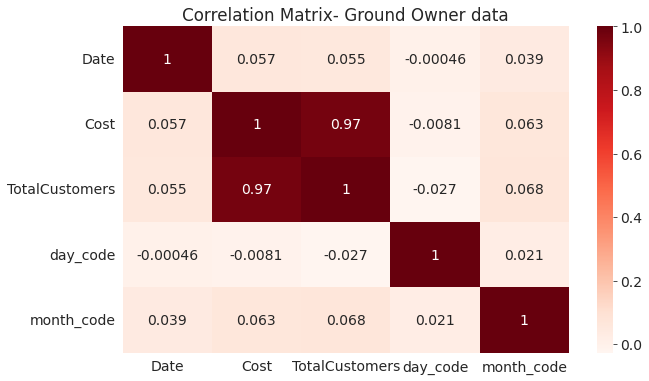

In [109]:
correlation_matrix_ground(gO1_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


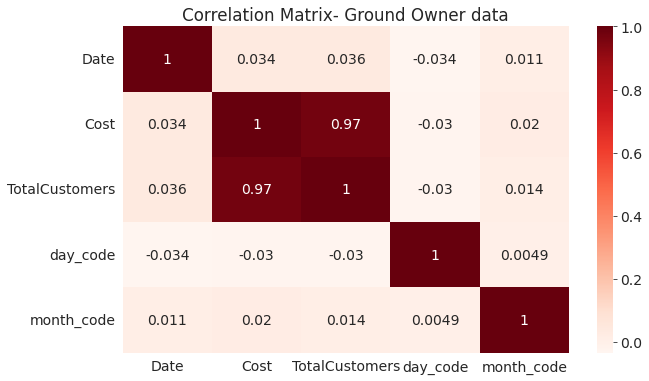

In [110]:
correlation_matrix_ground(gO2_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


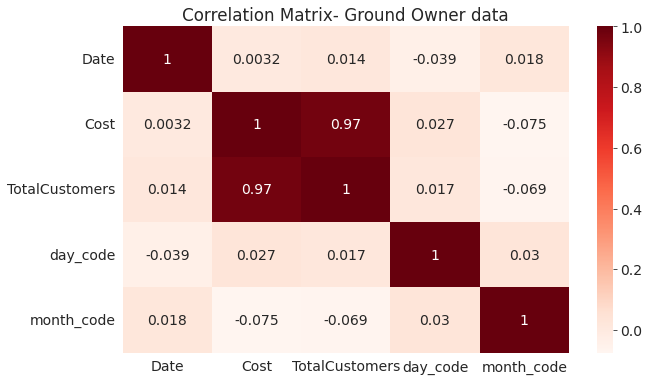

In [111]:
correlation_matrix_ground(gO3_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


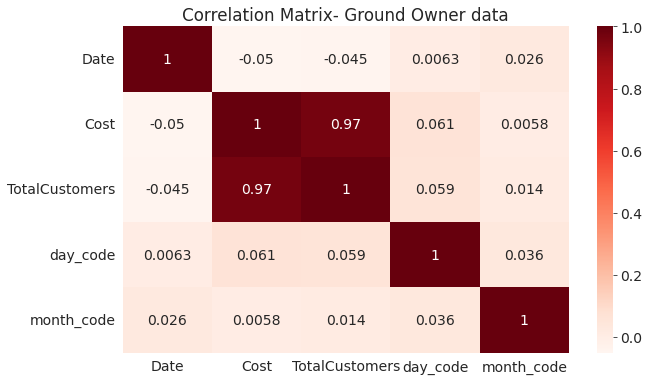

In [112]:
correlation_matrix_ground(gO4_Cost_df)

AxesSubplot(0.125,0.125;0.62x0.755)


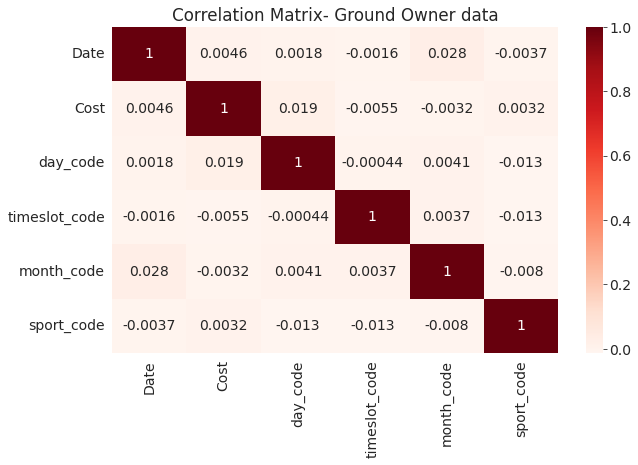

In [113]:
correlation_matrix_cust(gO1_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


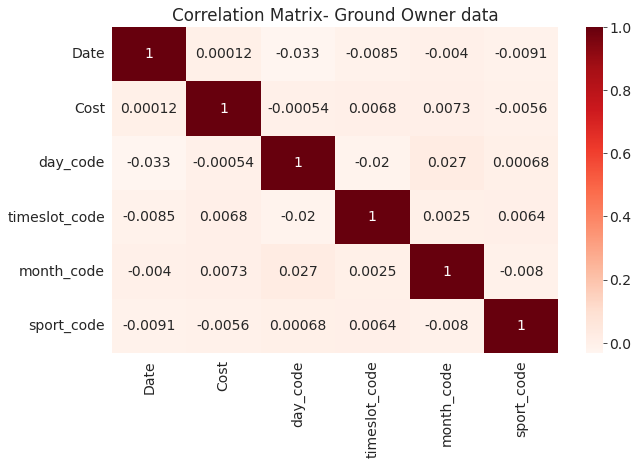

In [114]:
correlation_matrix_cust(gO2_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


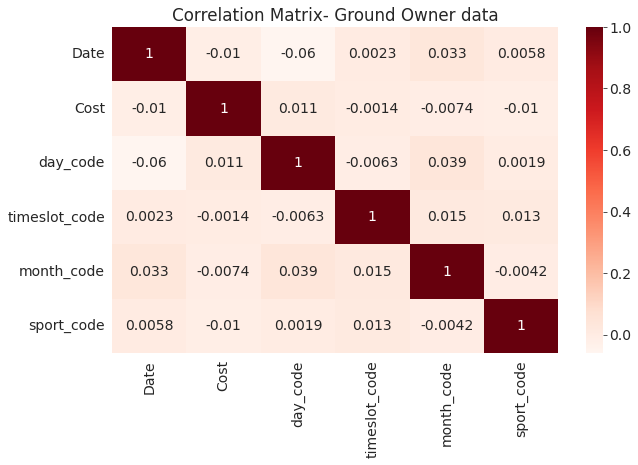

In [115]:
correlation_matrix_cust(gO3_Cust_df)

AxesSubplot(0.125,0.125;0.62x0.755)


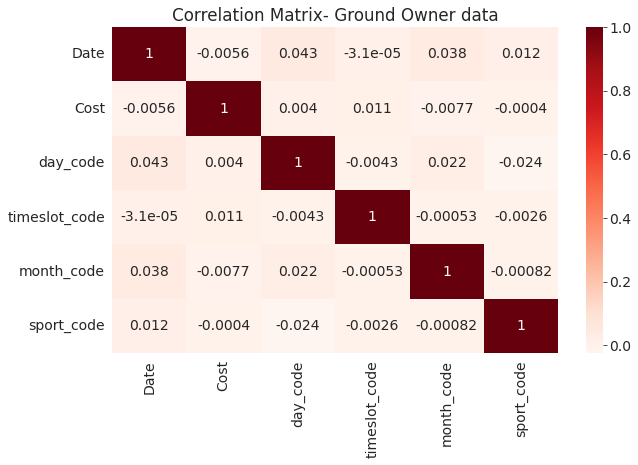

In [116]:
correlation_matrix_cust(gO4_Cust_df)

# Preprocessing for fitting into Models

In [117]:
print(gO1_Cost_df.shape)
gO1_Cost_df.head()

(782, 9)


,Date,Year,Day,Month,GroundName,Cost,TotalCustomers,day_code,month_code
12,13,2010,Sunday,January,Ground1,1800,9,6,0
14,15,2010,Saturday,July,Ground1,4200,18,5,6
18,19,2010,Thursday,March,Ground1,1900,7,3,2
19,20,2010,Saturday,July,Ground1,6600,28,5,6
21,22,2010,Sunday,July,Ground1,1950,7,6,6


In [118]:
gO1_Cost_df.nunique()

Date              782
Year               12
Day                 7
Month              12
GroundName          1
Cost              152
TotalCustomers     26
day_code            7
month_code         12
dtype: int64

In [119]:
gO1_Cost_df = gO1_Cost_df.drop(['Date','Year','GroundName','day_code','month_code'],axis=1)
# gO1_Cost_df = pd.get_dummies(gO1_Cost_df,drop_first=True)
gO1_Cost_df.head()

,Day,Month,Cost,TotalCustomers
12,Sunday,January,1800,9
14,Saturday,July,4200,18
18,Thursday,March,1900,7
19,Saturday,July,6600,28
21,Sunday,July,1950,7


In [120]:
gO1_Cost_df.shape

(782, 4)

In [121]:
print(gO1_Cust_df.shape)
gO1_Cust_df.head()

(12974, 12)


,Date,Year,Day,Month,TimeSlot,Sport,GroundName,Cost,day_code,timeslot_code,month_code,sport_code
205,13,2010,Sunday,January,timeslot4,sport4,Ground1,200,6,3,0,3
206,13,2010,Sunday,January,timeslot6,sport3,Ground1,250,6,5,0,2
207,13,2010,Sunday,January,timeslot7,sport3,Ground1,500,6,6,0,2
208,13,2010,Sunday,January,timeslot6,sport5,Ground1,100,6,5,0,4
209,13,2010,Sunday,January,timeslot7,sport2,Ground1,100,6,6,0,1


In [122]:
gO1_Cust_df.nunique()

Date             782
Year              12
Day                7
Month             12
TimeSlot           7
Sport              6
GroundName         1
Cost               9
day_code           7
timeslot_code      7
month_code        12
sport_code         6
dtype: int64

In [123]:
gO1_Cust_df = gO1_Cust_df.drop(['Date','Year','GroundName','day_code','month_code','timeslot_code','sport_code'],axis=1)
# gO1_Cust_df = pd.get_dummies(gO1_Cust_df,drop_first=True)
gO1_Cust_df.head()

,Day,Month,TimeSlot,Sport,Cost
205,Sunday,January,timeslot4,sport4,200
206,Sunday,January,timeslot6,sport3,250
207,Sunday,January,timeslot7,sport3,500
208,Sunday,January,timeslot6,sport5,100
209,Sunday,January,timeslot7,sport2,100


In [124]:
gO1_Cust_df.columns

Index(['Day', 'Month', 'TimeSlot', 'Sport', 'Cost'], dtype='object')

# Linear, Lasso , Ridge Models

In [125]:
linear_1 = gO1_Cost_df[['TotalCustomers','Cost']]
print(linear_1.shape)
linear_1.head()

(782, 2)


,TotalCustomers,Cost
12,9,1800
14,18,4200
18,7,1900
19,28,6600
21,7,1950


Text(0, 0.5, 'Revenue of that day')

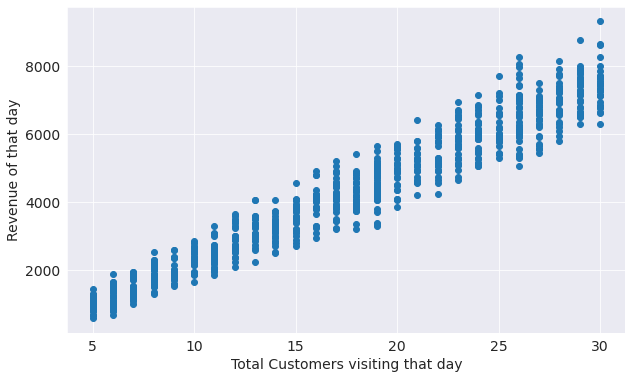

In [126]:
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [127]:
linear_1_X = linear_1.iloc[:,0:1]
linear_1_y = linear_1.iloc[:,-1]

In [128]:
linear_1_X.head()

,TotalCustomers
12,9
14,18
18,7
19,28
21,7


In [129]:
linear_1_y.head()

12    1800
14    4200
18    1900
19    6600
21    1950
Name: Cost, dtype: int64

In [130]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(linear_1_X,linear_1_y,test_size = 0.2,random_state=2)

In [131]:
from sklearn.linear_model import LinearRegression
lr_1 = LinearRegression()


In [132]:
lr_1.fit(X_train,y_train)

LinearRegression()

In [133]:
X_test.head()

,TotalCustomers
349,26
560,18
267,19
850,23
69,13


In [134]:
y_test.head()

349    7000
560    3950
267    4400
850    4950
69     2950
Name: Cost, dtype: int64

In [135]:
X_test.iloc[1]

TotalCustomers    18
Name: 560, dtype: int64

In [136]:
lr_1.predict(X_test.iloc[1].values.reshape(1,1))

array([4354.48704019])

In [137]:
#regression metrics 


Text(0, 0.5, 'Revenue of that day')

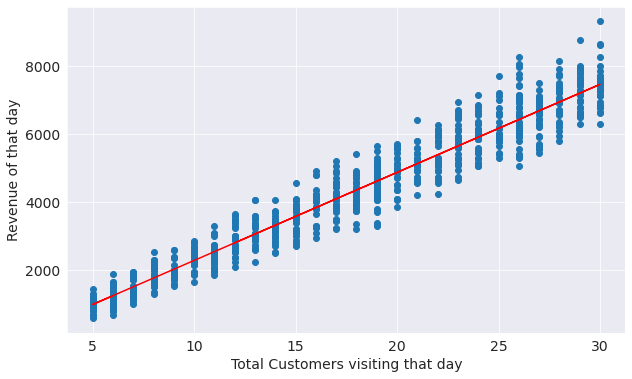

In [138]:
# line of best fit : 
plt.scatter(linear_1['TotalCustomers'],linear_1['Cost'])
plt.plot(X_train.to_numpy(),lr_1.predict(X_train),color='red')
plt.xlabel('Total Customers visiting that day')
plt.ylabel('Revenue of that day')

In [139]:
w_lr_1 = lr_1.coef_
b_lr_1 = lr_1.intercept_
print('weight:'+str(w_lr_1))
print('bias :'+str(b_lr_1))
# revenue = w * totalCust + b

weight:[258.28000052]
bias :-294.5529691954662


In [140]:
gO1_Cost_df

,Day,Month,Cost,TotalCustomers
12,Sunday,January,1800,9
14,Saturday,July,4200,18
18,Thursday,March,1900,7
19,Saturday,July,6600,28
21,Sunday,July,1950,7
...,...,...,...,...
2988,Monday,November,6550,26
2990,Sunday,October,5750,22
2995,Tuesday,October,1250,7
2996,Wednesday,January,7550,29


In [141]:
linear_2 = pd.get_dummies(gO1_Cost_df,drop_first=True)
print(linear_2.shape)
print(linear_2.columns)
linear_2.head()

(782, 19)
Index(['Cost', 'TotalCustomers', 'Day_Monday', 'Day_Saturday', 'Day_Sunday',
       'Day_Thursday', 'Day_Tuesday', 'Day_Wednesday', 'Month_August',
       'Month_December', 'Month_February', 'Month_January', 'Month_July',
       'Month_June', 'Month_March', 'Month_May', 'Month_November',
       'Month_October', 'Month_September'],
      dtype='object')


,Cost,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
12,1800,9,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0
14,4200,18,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
18,1900,7,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
19,6600,28,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
21,1950,7,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [142]:
# 18 dimensional hyperplane
# cost = b0 + b1.totCust + b2.day_mon + ... +b17.month_sept 


In [143]:
linear_2_X = linear_2.iloc[:,1:]
linear_2_y = linear_2.iloc[:,0]

In [144]:
print(linear_2_X.shape)
print(linear_2_y.shape)

(782, 18)
(782,)


In [145]:
linear_2_X

,TotalCustomers,Day_Monday,Day_Saturday,Day_Sunday,Day_Thursday,Day_Tuesday,Day_Wednesday,Month_August,Month_December,Month_February,Month_January,Month_July,Month_June,Month_March,Month_May,Month_November,Month_October,Month_September
12,9,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0
14,18,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
18,7,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
19,28,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
21,7,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2988,26,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2990,22,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
2995,7,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
2996,29,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0


In [146]:
linear_2_y

12      1800
14      4200
18      1900
19      6600
21      1950
        ... 
2988    6550
2990    5750
2995    1250
2996    7550
2997    1950
Name: Cost, Length: 782, dtype: int64

In [147]:
X_train,X_test,y_train,y_test = train_test_split(linear_2_X,linear_2_y,test_size=0.2,random_state=2)

In [148]:
lr_2 = LinearRegression()

In [149]:
lr_2.fit(X_train,y_train)

LinearRegression()

In [150]:
y_pred = lr_2.predict(X_test)

In [151]:
r2_score(y_test,y_pred)

0.945526096619064

In [152]:
lr_2.coef_ # b1 to b17

array([ 258.58339985, -183.94460299, -193.04189073,  -17.73135631,
       -108.62639216,  -83.07653305, -141.87551429,  -54.37936121,
        -66.68311294,  -28.78534409,  -35.84274031,   29.88798046,
         45.73929258,   59.04605443,   24.35311584,    6.0660097 ,
         -4.16730152,  -28.50034363])

In [153]:
lr_2.intercept_ # bias

-194.1630915789392

In [162]:
X_train,X_test,y_train,y_test = train_test_split(linear_2_X,linear_2_y,test_size=0.2,random_state=2)

In [179]:
class lr_2_pipeline:
    def __init__(self):
        self.coef_ = None
        self.intercept_ = None
        
    def fit(self,X_train,y_train):
        X_t = np.insert(X_train,0,1,axis=1)
        
        
#         betas = np.linalg.inv(np.dot(X_train.T,X_train)).dot(X_train.T).dot(y_train)
#         print(betas)
        print(X_t.shape)
    
    def predict(self,X_test):
       pass 

In [180]:
lr_2_pip = lr_2_pipeline()

In [181]:
X_train.shape

(625, 18)

In [182]:
lr_2_pip.fit(X_train,y_train)

ValueError: Shape of passed values is (625, 19), indices imply (625, 18)

In [ ]:
# hyperplane for 3d data 
from sklearn.datasets import make_regression
import plotly.express as px
import plotly.graph_objects as go

from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [ ]:
try_X,try_y = make_regression(n_samples = 1000, n_features = 2, n_informative=2,n_targets= 1,noise=50)


In [ ]:
try_df = pd.DataFrame({'feature1':try_X[:,0],'feature2':try_X[:,1],'target':try_y})

In [ ]:
try_df.head()

In [ ]:
try_df.shape

In [ ]:
try_fig = px.scatter_3d(try_df,x='feature1',y='feature2',z='target')

In [ ]:
try_fig.show()

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(try_X,try_y,test_size=0.2,random_state=3)


In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
lr = LinearRegression()
lr.fit(X_train,y_train)

In [ ]:
y_pred = lr.predict(X_test)

In [ ]:
print("Mean Absolute error",mean_absolute_error(y_test,y_pred))
print("Mean Square error",mean_squared_error(y_test,y_pred))
print("R2 score",r2_score(y_test,y_pred))

In [ ]:
x = np.linspace(-5, 5, 10)
y = np.linspace(-5, 5, 10)
xGrid, yGrid = np.meshgrid(y, x)

z_final = lr.predict(X_test).reshape(10,10)

z = z_final

final = np.vstack((xGrid.ravel().reshape(1,100),yGrid.ravel().reshape(1,100))).T

In [ ]:
fig = px.scatter_3d(df, x='feature1', y='feature2', z='target')

fig.add_trace(go.Surface(x = x, y = y, z =z ))

fig.show()

# Decision Tree

# Random Forest 

# XG Boosting